In [1]:
!pip install tbats

In [2]:
!pip install pmdarima

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Importing Libraries

In [4]:
# Standard library imports
import os
import pickle

# Third-party library imports
import numpy as np  # Numerical operations
import pandas as pd  # Data manipulation and analysis
import matplotlib.pyplot as plt  # Plotting
import seaborn as sns  # Statistical data visualization

# Scikit-learn imports for preprocessing and model evaluation
from sklearn.preprocessing import RobustScaler, StandardScaler, MinMaxScaler  # Data scaling
from sklearn.model_selection import train_test_split  # Splitting data into train and test sets
from sklearn.metrics import mean_squared_error  # Model evaluation metric

# Statsmodels imports for time series analysis
from statsmodels.tsa.stattools import adfuller, kpss  # Statistical tests for stationarity
from statsmodels.tsa.arima.model import ARIMA  # ARIMA model
from statsmodels.tsa.statespace.sarimax import SARIMAX  # SARIMAX model
import statsmodels.api as sm  # General statsmodels API

# Pmdarima imports for automated ARIMA modeling
from pmdarima import auto_arima
import pmdarima as pm

# TBATS model for time series forecasting
from tbats import TBATS


In [5]:
import warnings
warnings.filterwarnings("ignore")


## Load your dataset

In [6]:
data = pd.read_csv('/content/expanded_dataset.csv')


### Look at Dataset

In [7]:
data.sample(5)


,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
64889,2018-03-27 14:50:00,25.657233,43.637321,0.086848,753.661608,800.279440,33296.973620,19502.870977,17630.125937
58914,2018-02-14 03:00:00,15.205635,64.758460,0.035541,7.235665,0.859670,22298.500980,13766.503038,14305.075932
29404,2017-07-24 04:40:00,24.800000,52.620000,4.904000,0.124000,0.096000,28602.259140,19181.012660,24564.351460
81577,2018-07-21 12:10:00,30.864857,59.115419,4.936092,843.691236,69.521185,38435.141833,27166.044000,31439.164316
49414,2017-12-10 03:40:00,6.804000,85.500000,0.087000,0.073000,0.156000,20745.247150,16024.547410,9507.803121


#### Converting  'Datetime' column to datetime

In [8]:
# data['Datetime'] = pd.to_datetime(data['Datetime'], format='%m/%d/%Y %H:%M', dayfirst=True)
data['Datetime'] = pd.to_datetime(data['Datetime'], format='%Y-%m-%d %H:%M:%S', errors='coerce')


Set the 'Dates' column as the index

In [9]:
data.set_index('Datetime', inplace=True)


In [10]:
data['TotalPowerConsumption']= data['PowerConsumption_Zone1'] + data['PowerConsumption_Zone2'] + data['PowerConsumption_Zone3']


In [11]:
data= data.drop(['PowerConsumption_Zone1','PowerConsumption_Zone2','PowerConsumption_Zone3'],axis=1)


## Checking for Missing values

In [12]:
data.isnull().sum()


,0
Temperature,0
Humidity,0
WindSpeed,0
GeneralDiffuseFlows,0
DiffuseFlows,0
TotalPowerConsumption,0


In [13]:
print('Index frequency:', pd.infer_freq(data.index)) #https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases
print('Number of missing values:', data.isnull().sum())


Index frequency: 10min
Number of missing values: Temperature              0
Humidity                 0
WindSpeed                0
GeneralDiffuseFlows      0
DiffuseFlows             0
TotalPowerConsumption    0
dtype: int64


In [14]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

def plot_numeric_boxplots(df, cols_per_row=3):
    """
    Create box plots for numeric columns in a DataFrame, arranged in multiple rows.

    Parameters:
        df (DataFrame): The input DataFrame.
        cols_per_row (int): Number of plots per row.

    Returns:
        None
    """
    # Select numeric columns
    numeric_cols = df.select_dtypes(include='number')
    num_cols = len(numeric_cols.columns)
    rows = (num_cols // cols_per_row) + (num_cols % cols_per_row > 0)

    # Create subplots
    fig = make_subplots(
        rows=rows, cols=cols_per_row,
        subplot_titles=numeric_cols.columns
    )

    # Add box plot traces
    for i, col in enumerate(numeric_cols.columns):
        row = (i // cols_per_row) + 1
        col_position = (i % cols_per_row) + 1
        fig.add_trace(
            go.Box(y=numeric_cols[col], name=col, boxmean=True),
            row=row, col=col_position
        )

    # Update layout
    fig.update_layout(
        height=rows * 400,  # Adjust height dynamically based on the number of rows
        width=cols_per_row * 200,
        title_text="Box Plots for Numeric Columns",
        showlegend=False,
        template="plotly_dark"
    )

    # Show the figure
    fig.show()


In [15]:
plot_numeric_boxplots(data, cols_per_row=6)


## Checking for Outliers

Some Outliers found. Lets remove them

In [16]:
RS = RobustScaler()


In [17]:
x = data.drop(['TotalPowerConsumption'],axis=1)
y = data['TotalPowerConsumption']


In [18]:
plot_numeric_boxplots(x, cols_per_row=5)



In [19]:
scaled_x = RS.fit_transform(x)


In [20]:
x= pd.DataFrame(scaled_x, columns=x.columns)


In [21]:
plot_numeric_boxplots(x, cols_per_row=5)


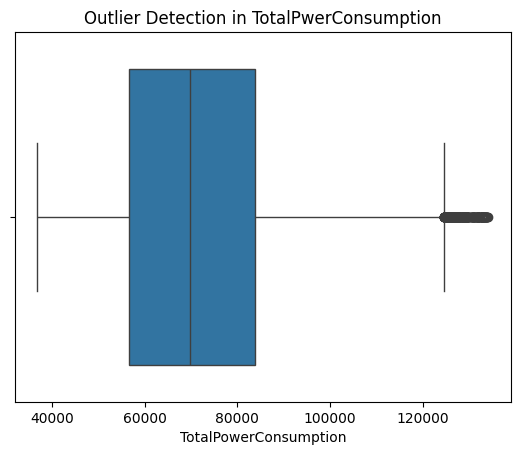

In [22]:
sns.boxplot(x='TotalPowerConsumption',data=data)
plt.title('Outlier Detection in TotalPwerConsumption')
plt.show()


In [23]:
Q1 = data['TotalPowerConsumption'].quantile(0.25)
Q3 = data['TotalPowerConsumption'].quantile(0.75)

IQR = Q3 - Q1

lowerbound = Q1 - (1.5 * IQR)
upperbound = Q3 + (1.5 * IQR)

data = data[(data.TotalPowerConsumption >= lowerbound) & (data.TotalPowerConsumption <= upperbound)]


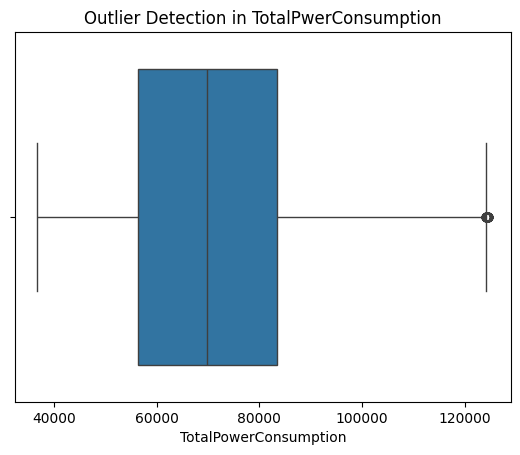

In [24]:
sns.boxplot(x='TotalPowerConsumption',data=data)
plt.title('Outlier Detection in TotalPwerConsumption')
plt.show()


## Checking and Fixing Data Distribution

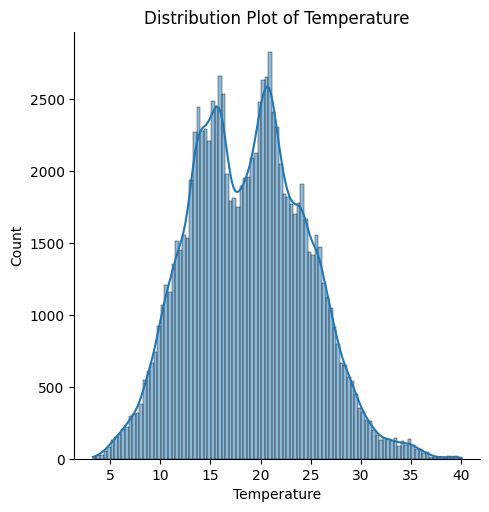

In [25]:
sns.displot(data['Temperature'], kde=True)
plt.title('Distribution Plot of Temperature')
plt.show()


In [26]:
data['Temperature'].skew()


0.19829714862896625

In [27]:
from scipy.stats import boxcox
data['Temperature'], lambda_boxcox = boxcox(data['Temperature'])


In [28]:
data['Temperature'].skew()


-0.02839630773123882

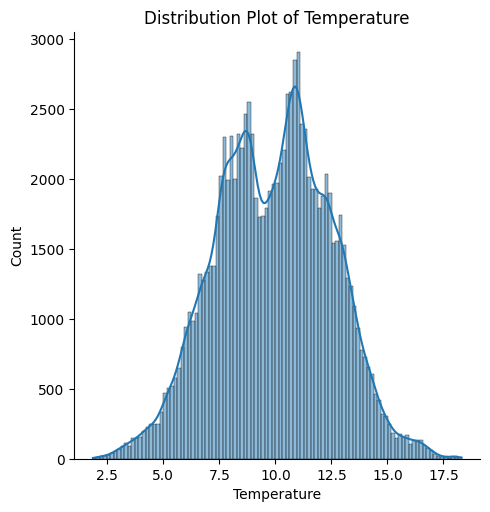

In [29]:
sns.displot(data['Temperature'], kde=True)
plt.title('Distribution Plot of Temperature')
plt.show()


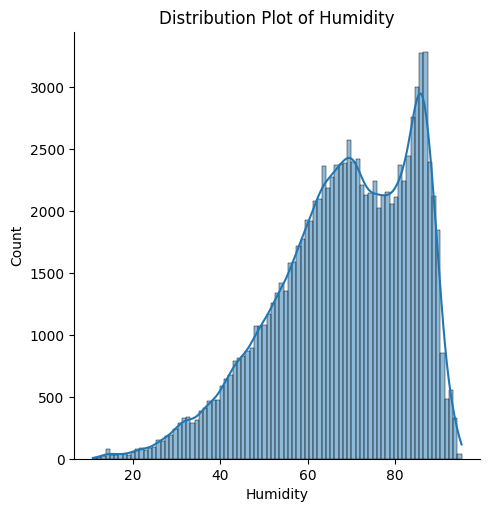

In [30]:
sns.displot(data['Humidity'], kde=True)
plt.title('Distribution Plot of Humidity')
plt.show()


In [31]:
data['Humidity'].skew()


-0.6262900442576601

In [32]:
from sklearn.preprocessing import PowerTransformer
pt = PowerTransformer(method='yeo-johnson')
data['Humidity'] = pt.fit_transform(data[['Humidity']])


In [33]:
data['Humidity'].skew()


-0.16288105385463145

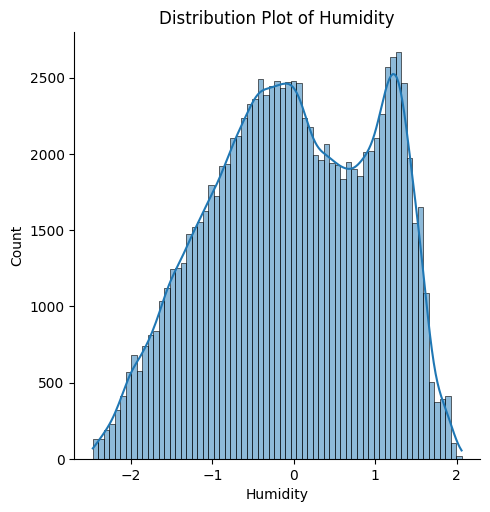

In [34]:
sns.displot(data['Humidity'], kde=True)
plt.title('Distribution Plot of Humidity')
plt.show()


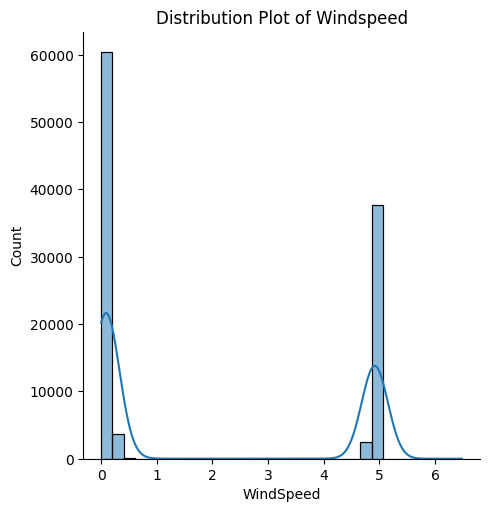

In [35]:
sns.displot(data['WindSpeed'], kde=True)
plt.title('Distribution Plot of Windspeed')
plt.show()


In [36]:
data['WindSpeed'].skew()


0.46920106192799926

In [37]:
from scipy.stats import boxcox
data['WindSpeed'], lambda_boxcox = boxcox(data['WindSpeed'])


In [38]:
data['WindSpeed'].skew()


0.05264045037324678

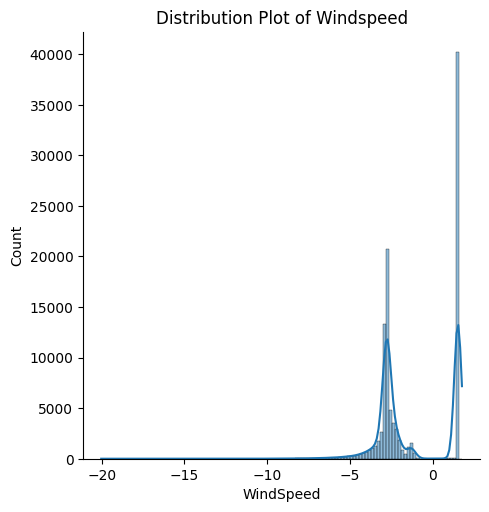

In [39]:
sns.displot(data['WindSpeed'], kde=True)
plt.title('Distribution Plot of Windspeed')
plt.show()


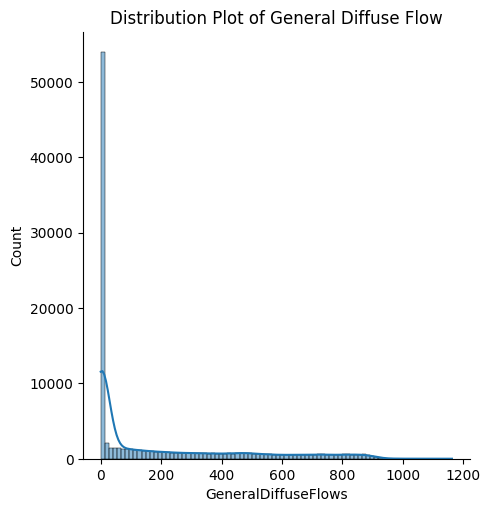

In [40]:
sns.displot(data['GeneralDiffuseFlows'], kde=True)
plt.title('Distribution Plot of General Diffuse Flow')
plt.show()


In [41]:
data['GeneralDiffuseFlows'].skew()


1.3068020114536902

In [42]:
data['GeneralDiffuseFlows'], lambda_boxcox = boxcox(data['GeneralDiffuseFlows'])


In [43]:
data['GeneralDiffuseFlows'].skew()


-0.12132123454160398

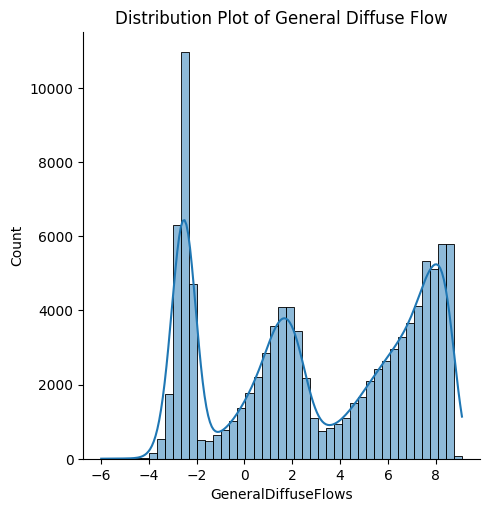

In [44]:
sns.displot(data['GeneralDiffuseFlows'], kde=True)
plt.title('Distribution Plot of General Diffuse Flow')
plt.show()


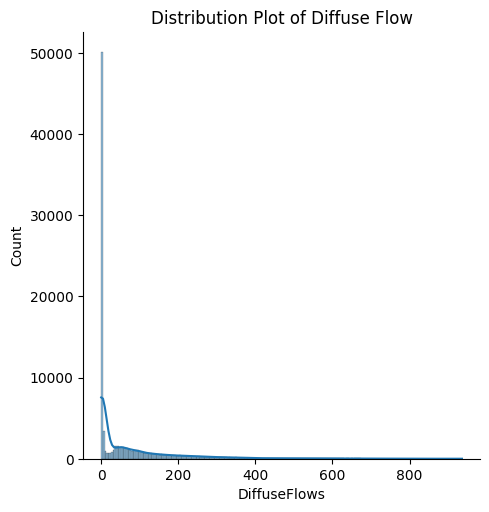

In [45]:
sns.displot(data['DiffuseFlows'], kde=True)
plt.title('Distribution Plot of Diffuse Flow')
plt.show()


In [46]:
data['DiffuseFlows'].skew()


2.461022275638873

In [47]:
data['DiffuseFlows'], lambda_boxcox = boxcox(data['DiffuseFlows'])


In [48]:
data['DiffuseFlows'].skew()


-0.06847936353006993

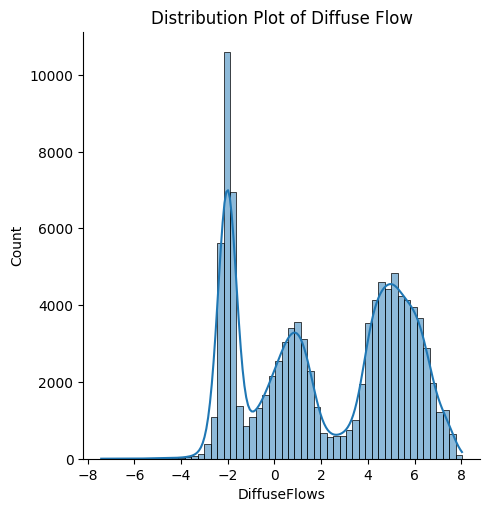

In [49]:
sns.displot(data['DiffuseFlows'], kde=True)
plt.title('Distribution Plot of Diffuse Flow')
plt.show()


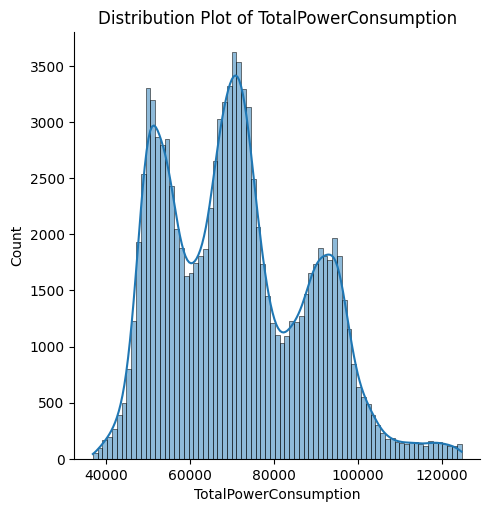

In [50]:
sns.displot(data['TotalPowerConsumption'], kde=True)
plt.title('Distribution Plot of TotalPowerConsumption')
plt.show()


In [51]:
data['TotalPowerConsumption'].skew()


0.46414828772785804

In [52]:
data['TotalPowerConsumption'], lambda_boxcox = boxcox(data['TotalPowerConsumption'])


In [53]:
data['TotalPowerConsumption'].skew()


0.0024846072171040364

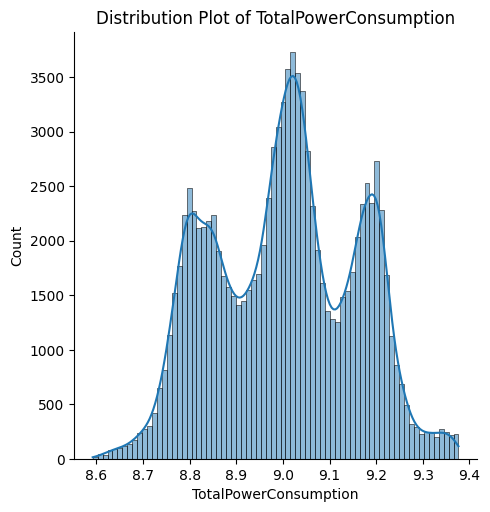

In [54]:
sns.displot(data['TotalPowerConsumption'], kde=True)


plt.title('Distribution Plot of TotalPowerConsumption')
plt.show()


In [55]:
plot_numeric_boxplots(data, cols_per_row=3)


In [56]:
x= data.drop(['TotalPowerConsumption'],axis=1)
y=data['TotalPowerConsumption']


In [57]:
import plotly.graph_objects as go

# Filter the data for the specified date range
filtered_data = y['2018-12-01 00:00:00':]

# Create the figure
fig = go.Figure()

# Add the trace
fig.add_trace(go.Scatter(x=filtered_data.index, y=filtered_data, mode='lines', line=dict(color='red')))

# Update the layout
fig.update_layout(
    title='Total power consumption time series',
    xaxis_title='Datetime',
    yaxis_title='Power Consumption',
    width=1800,
    height=700
)

# Show the figure
fig.show()


In [58]:
def adf_test(timeseries):
    print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(dftest[0:4], index=["Test Statistic", "p-value",
                                             "Lags Used", "Number of Observations Used"])
    for key, value in dftest[4].items():
        dfoutput["Critical Value (%s)" % key] = value
    print(dfoutput)

def kpss_test(timeseries):
    print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags="auto")
    kpss_output = pd.Series(
        kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"])
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    print(kpss_output)


## Scaling

In [59]:
Scaler = StandardScaler()


In [60]:
x_scaled = Scaler.fit_transform(x)


In [61]:
x_scaled


array([[-2.32395488,  0.27737431, -0.70053806, -1.39754225, -1.29659904],
       [-2.35738217,  0.32906903, -0.70053806, -1.33366125, -1.39007887],
       [-2.38079206,  0.32906903, -0.7202187 , -1.35830784, -1.34510681],
       ...,
       [-2.30005412,  0.19378647, -0.39681307, -0.81746209, -0.09803087],
       [-2.30774554,  0.21196118, -0.65881988, -0.30141186, -0.45357203],
       [-2.36382022,  0.29849024, -0.34952245, -0.23018994, -0.48847803]])

In [62]:
x_scaled.shape


(104534, 5)

In [63]:
y.shape


(104534,)

In [64]:
x_train,x_test,y_train,y_test= train_test_split(x,y,test_size=0.2,random_state=42)


#### AdFuller Report

In [65]:
adf_test(y_train)
print('\nDifferentiations needed according to ADF:', pm.arima.utils.ndiffs(y_train, test='adf'))
print('\n')
kpss_test(y_train)
print('\nDifferentiations needed according to KPSS:', pm.arima.utils.ndiffs(y_train, test='kpss'))


Results of Dickey-Fuller Test:
Test Statistic                  -289.848238
p-value                            0.000000
Lags Used                          0.000000
Number of Observations Used    83626.000000
Critical Value (1%)               -3.430428
Critical Value (5%)               -2.861575
Critical Value (10%)              -2.566788
dtype: float64

Differentiations needed according to ADF: 0


Results of KPSS Test:
Test Statistic            0.063918
p-value                   0.100000
Lags Used                12.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64

Differentiations needed according to KPSS: 0


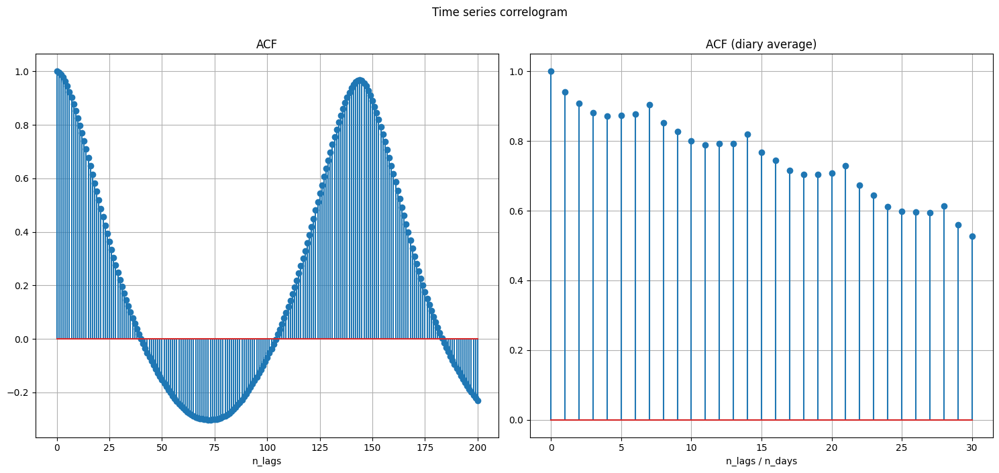

In [66]:
fas_d = sm.tsa.acf(y, nlags=200)
fas_s = sm.tsa.acf(y.resample('D').mean(), nlags=30)

fig, axs = plt.subplots(1, 2, figsize=(15,7))
fig.suptitle('Time series correlogram', y=1)
axs[0].stem(fas_d)
axs[0].set_title('ACF')
axs[0].set_xlabel('n_lags')
axs[0].grid(True)
axs[1].stem(fas_s)
axs[1].set_title('ACF (diary average)')
axs[1].set_xlabel('n_lags / n_days')
axs[1].grid(True)
plt.tight_layout()
plt.show()


## ARIMA

In [67]:
if os.path.exists('/content/drive/MyDrive/Model/search_arima_model_auto.pkl'):
    print("Model already trained and saved at", '/content/drive/MyDrive/Model/search_arima_model_auto.pkl')
    with open('/content/drive/MyDrive/Model/search_arima_model_auto.pkl', 'rb') as pkl_file:
        a_auto_model = pickle.load(pkl_file)
else:
    a_auto_model = pm.auto_arima(y_train, start_p=1, start_q=1, d=1,D=1,
                                    max_p=10, max_q=10, max_d=10,
                                    max_order=None,
                                    m=7,
                                    seasonal=False,
                                    test='adf',
                                    n_jobs=-1,
                                    trace=True,
                                    error_action='ignore')

    with open('/content/drive/MyDrive/Model/search_arima_model_auto.pkl', 'wb') as pkl_file:
        pickle.dump(a_auto_model, pkl_file)



Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=91.31 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-19406.860, Time=13.41 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-43525.007, Time=14.81 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=64.51 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-19408.860, Time=2.96 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-53489.989, Time=26.30 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-59024.792, Time=40.87 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=-62321.814, Time=38.50 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=-64634.065, Time=38.46 sec
 ARIMA(6,1,0)(0,0,0)[0] intercept   : AIC=-66284.329, Time=78.49 sec
 ARIMA(7,1,0)(0,0,0)[0] intercept   : AIC=-67648.144, Time=53.86 sec
 ARIMA(7,1,1)(0,0,0)[0] intercept   : AIC=-75801.362, Time=256.66 sec
 ARIMA(6,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=236.79 sec
 ARIMA(7,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=405.48 sec
 ARIMA(6,1,2)(0,0

In [68]:
a_auto_model.fit(y_train)


ARIMA(order=(7, 1, 1), scoring_args={}, suppress_warnings=True)

In [69]:
arima_pred = a_auto_model.predict(n_periods=len(y_test))


In [70]:
print(a_auto_model.summary())


                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                83627
Model:               SARIMAX(7, 1, 1)   Log Likelihood               37910.681
Date:                Thu, 06 Feb 2025   AIC                         -75801.362
Time:                        13:07:50   BIC                         -75708.021
Sample:                             0   HQIC                        -75772.806
                              - 83627                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept    2.27e-06   1.45e-05      0.156      0.876   -2.62e-05    3.08e-05
ar.L1          0.0083      0.004      2.278      0.023       0.001       0.015
ar.L2          0.0193      0.004      5.322      0.0

In [71]:
mse = mean_squared_error(y_test, arima_pred)
print(f'Mean Squared Error: {mse}')


Mean Squared Error: 0.02360888246642244


## SRIMAX

In [76]:
def func(tru):
  if os.path.exists('/content/drive/MyDrive/Model/search_sarima_model_auto.pkl') and tru:
      print("Model already trained and saved at", '/content/drive/MyDrive/Model/search_sarima_model_auto.pkl')
      with open('/content/drive/MyDrive/Model/search_sarima_model_auto.pkl', 'rb') as pkl_file:
          auto_model = pickle.load(pkl_file)
  else:
    auto_model = pm.auto_arima(y_train,d=1,m=30, seasonal=True, trace=True, error_action='ignore',suppress_warnings=True)
    with open('/content/drive/MyDrive/Model/search_sarima_model_auto.pkl', 'wb') as pkl_file:
      pickle.dump(auto_model, pkl_file)
  return auto_model


In [78]:
auto_model=func(True)

Model already trained and saved at /content/drive/MyDrive/Model/search_sarima_model_auto.pkl


In [79]:
auto_model.fit(y_train)

ARIMA(order=(5, 1, 2), scoring_args={}, suppress_warnings=True)

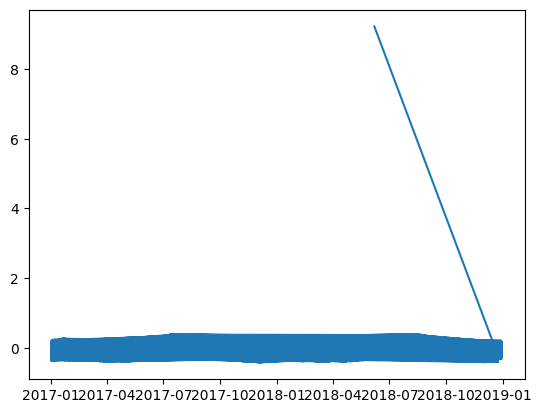

In [80]:
import matplotlib.pyplot as plt

residuals = auto_model.resid()
plt.plot(residuals)
plt.show()

In [81]:
# with open('search_sarima_model_auto.pkl', 'rb') as pkl_file:
#     auto_model = pickle.load(pkl_file)


In [82]:
sarimax_pred = auto_model.predict(n_periods=len(y_test))


In [83]:
print(auto_model.summary())


                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                83627
Model:               SARIMAX(5, 1, 2)   Log Likelihood               38519.359
Date:                Thu, 06 Feb 2025   AIC                         -77020.717
Time:                        13:49:40   BIC                         -76936.710
Sample:                             0   HQIC                        -76995.017
                              - 83627                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -5.172e-06   1.18e-05     -0.438      0.661   -2.83e-05     1.8e-05
ar.L1         -0.7006      0.578     -1.212      0.225      -1.834       0.432
ar.L2         -0.0108      0.005     -2.376      0.0

In [84]:
mse = mean_squared_error(y_test, sarimax_pred)
print(f'Mean Squared Error (SARIMAX): {mse}')


Mean Squared Error (SARIMAX): 0.024515312459787646


In [85]:
distinct_counts = len(np.unique(sarimax_pred))
print(distinct_counts)

20907


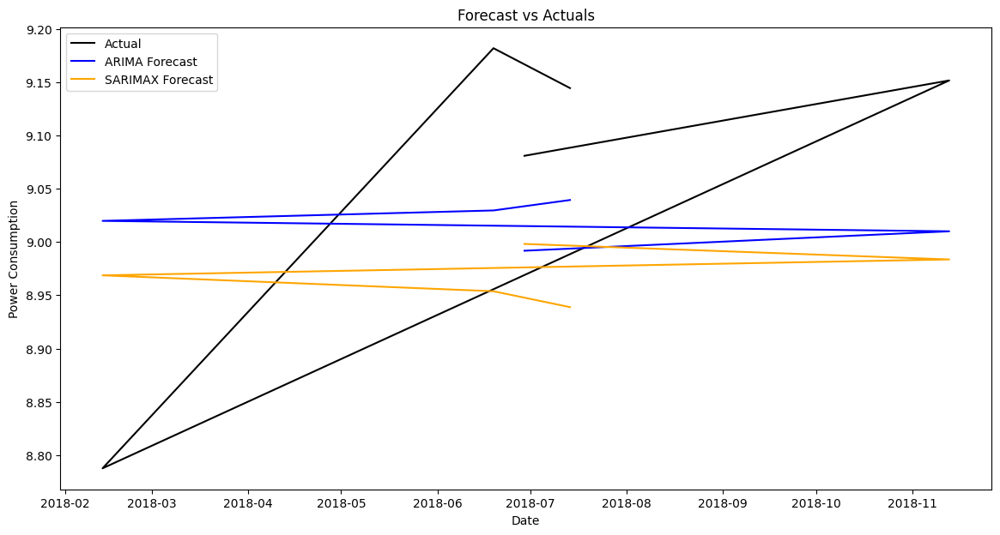

In [108]:
# Plotting results
step = 5000

plt.figure(figsize=(14, 7))
plt.plot(x_test.index[::step], y_test[::step], label='Actual', color='black')  # Actual values
plt.plot(x_test.index[::step], arima_pred[::step], label='ARIMA Forecast', color='blue')  # ARIMA forecast
plt.plot(x_test.index[::step], sarimax_pred[::step], label='SARIMAX Forecast', color='orange')  # SARIMAX forecast
plt.title('Forecast vs Actuals')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()


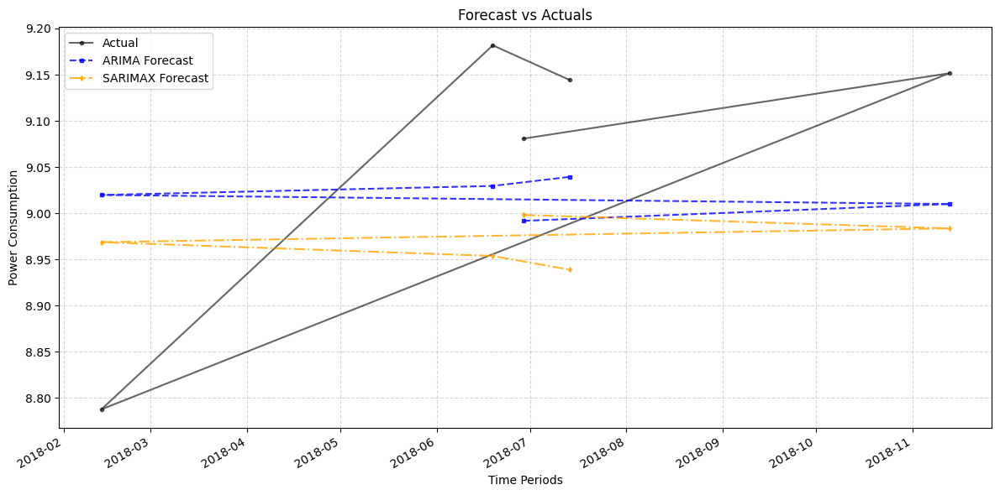

In [87]:
import matplotlib.pyplot as plt
import pandas as pd

# Downsample every 10th point (adjust as needed)
step = 5000
x_subset = x_test.index[::step]
y_subset = y_test[::step]
arima_subset = arima_pred[::step]
sarimax_subset = sarimax_pred[::step]

# Set figure size
plt.figure(figsize=(12, 6))

# Plot actual values
plt.plot(x_subset, y_subset, label='Actual', color='black', linestyle='-', marker='o', markersize=3, alpha=0.6)

# Plot ARIMA forecast
plt.plot(x_subset, arima_subset, label='ARIMA Forecast', color='blue', linestyle='--', marker='s', markersize=3, alpha=0.8)

# Plot SARIMAX forecast
plt.plot(x_subset, sarimax_subset, label='SARIMAX Forecast', color='orange', linestyle='-.', marker='d', markersize=3, alpha=0.8)

# Adding titles and labels
plt.title('Forecast vs Actuals')
plt.xlabel('Time Periods')
plt.ylabel('Power Consumption')

# Improve x-tick readability
plt.xticks(rotation=30, ha='right')

plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)  # Add grid for better readability
plt.tight_layout()
plt.show()


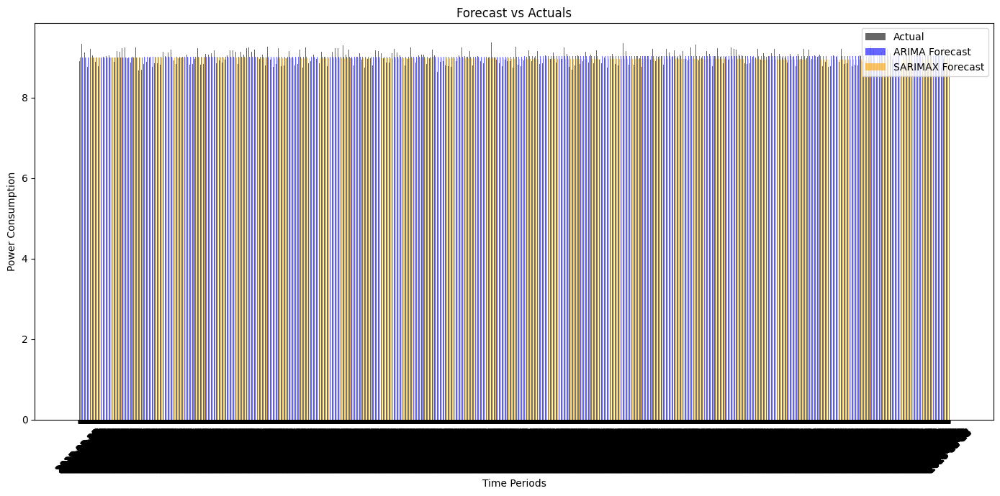

In [109]:
# Prepare the x-axis positions
x_positions = np.arange(len(x_test))

# Create the bar width
bar_width = 0.25

# Plotting results using bar charts
plt.figure(figsize=(14, 7))

# Actual values
plt.bar(x_positions, y_test, width=bar_width, label='Actual', color='black', alpha=0.6)

# ARIMA forecast
plt.bar(x_positions + bar_width, arima_pred, width=bar_width, label='ARIMA Forecast', color='blue', alpha=0.6)

# SARIMAX forecast
plt.bar(x_positions + 2 * bar_width, sarimax_pred, width=bar_width, label='SARIMAX Forecast', color='orange', alpha=0.6)

# Adding titles and labels
plt.title('Forecast vs Actuals')
plt.xlabel('Time Periods')
plt.ylabel('Power Consumption')
plt.xticks(x_positions + bar_width, x_test.index.date, rotation=45)  # Rotate date labels for better readability
plt.legend()
plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
plt.show()


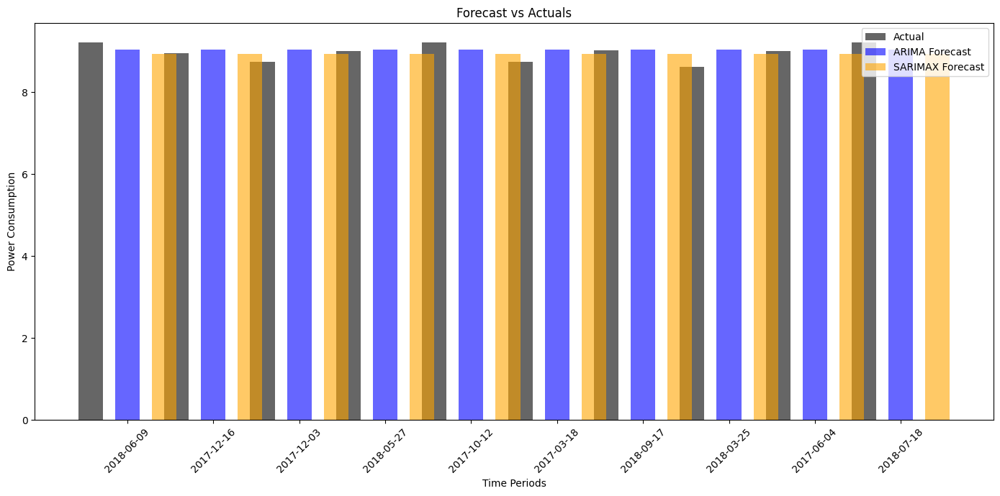

In [117]:
# Select the last 'num_obs' observations
num_obs = 10  # Adjust as needed
x_test_subset = x_test.iloc[-num_obs:]  # Keep the original index
y_test_subset = y_test.iloc[-num_obs:]
arima_pred_subset = arima_pred[-num_obs:]
sarimax_pred_subset = sarimax_pred[-num_obs:]

# Adjust x_positions
bar_width = 0.2
spacing = 0.1
x_positions = np.arange(num_obs) * (bar_width * 3 + spacing)

plt.figure(figsize=(14, 7))

# Actual values
plt.bar(x_positions, y_test_subset, width=bar_width, label='Actual', color='black', alpha=0.6)

# ARIMA forecast
plt.bar(x_positions + bar_width + spacing, arima_pred_subset, width=bar_width, label='ARIMA Forecast', color='blue', alpha=0.6)

# SARIMAX forecast
plt.bar(x_positions + 2 * (bar_width + spacing), sarimax_pred_subset, width=bar_width, label='SARIMAX Forecast', color='orange', alpha=0.6)

# Labels and display adjustments
plt.title('Forecast vs Actuals')
plt.xlabel('Time Periods')
plt.ylabel('Power Consumption')
plt.xticks(x_positions + (bar_width + spacing), x_test_subset.index.date, rotation=45)  # Use index directly
plt.legend()
plt.tight_layout()
plt.show()


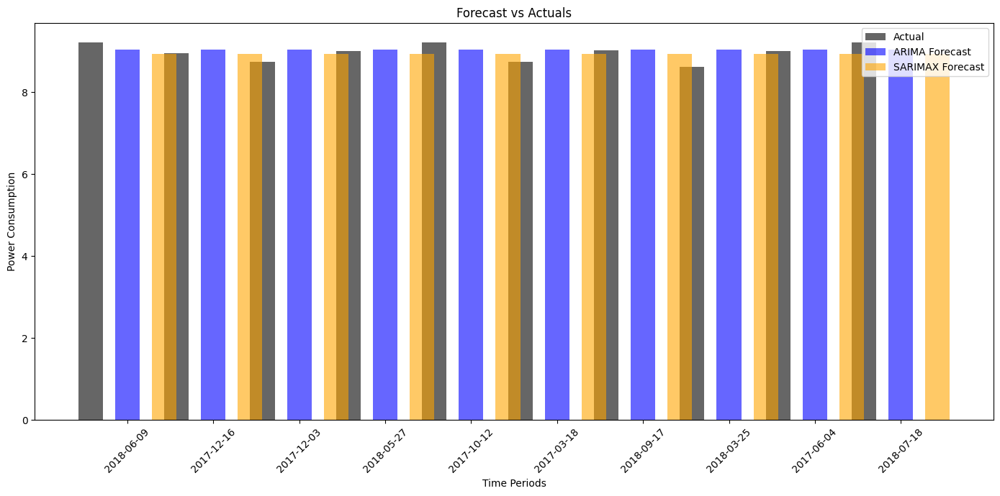

In [88]:
# print('TBATS model summary:\n', fitted_model.summary())
train = y[:'2018-09-30 23:50:00']
test = y['2018-10-01 00:00:00':]

#MODEL
estimator = TBATS(seasonal_periods=[144, 1008], use_trend=False)

if os.path.exists('/content/drive/MyDrive/Model/search_tvats_model_auto.pkl'):
    print("Model already trained and saved at", '/content/drive/MyDrive/Model/search_tvats_model_auto.pkl')
    with open('/content/drive/MyDrive/Model/search_tvats_model_auto.pkl', 'rb') as pkl_file:
        fitted_model = pickle.load(pkl_file)
else:
  fitted_model = estimator.fit(train)
  with open('/content/drive/MyDrive/Model/search_tvats_model_auto.pkl', 'wb') as pkl_file:
    pickle.dump(fitted_model, pkl_file)



Model already trained and saved at /content/drive/MyDrive/Model/search_tvats_model_auto.pkl


In [89]:

print('TBATS model summary:\n', fitted_model.summary())

pred_train = pd.Series(data=fitted_model.y_hat, index=train.index)

pred_test, conf_test = fitted_model.forecast(steps=len(test), confidence_level=0.95)
pred_test = pd.Series(data=pred_test, index=test.index)
conf_test = pd.DataFrame(data={'lower_bound':conf_test['lower_bound'], 'upper_bound':conf_test['upper_bound']}, index=test.index)

err_train = pd.Series(data=fitted_model.resid, index=train.index)
err_test = test - pred_test
err = pd.concat([err_train, err_test])

TBATS model summary:
 Use Box-Cox: True
Use trend: False
Use damped trend: False
Seasonal periods: [ 144. 1008.]
Seasonal harmonics [6 6]
ARMA errors (p, q): (3, 3)
Box-Cox Lambda 0.971407
Smoothing (Alpha): 1.083380
Seasonal Parameters (Gamma): [-1.17572249e-04  2.68442313e-05 -4.56920167e-05 -1.97118255e-04]
AR coefficients [-4.56920167e-05 -1.97118255e-04  3.80206926e-01]
MA coefficients [ 0.5374933   0.41753372 -0.07574199]
Seed vector [ 7.65833709e+00 -3.79454723e-03  1.79096957e-02 -3.21684586e-02
 -7.65485015e-03  2.95568095e-03 -1.81143994e-03 -1.49532941e-01
 -5.73274232e-02  1.31397721e-02  2.24098548e-03 -5.72146756e-03
 -1.21573690e-03 -1.27774019e-02 -3.54079577e-03 -1.17419260e-03
  2.07378698e-03  3.73975941e-03  6.67287074e-03  5.21930202e-03
  3.23151640e-03  1.50636038e-03  1.26676782e-03  5.55128055e-04
  1.41776621e-03  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00]

AIC 141321.416712


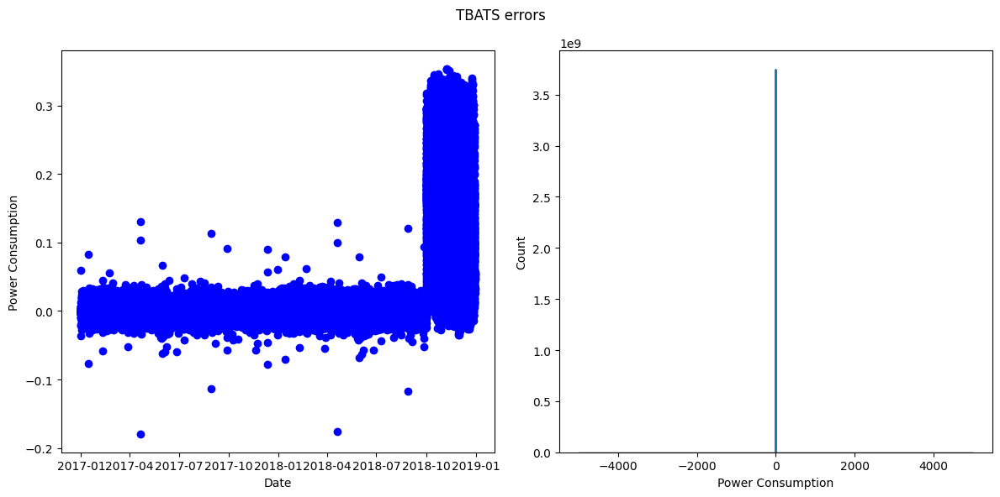

In [102]:
#Whole visualization
# plt.figure(figsize=(18,9))
# plt.plot(train, color='red', linestyle='-', label='Train')
# plt.plot(test, color='indianred', linestyle='-', label='Test')
# plt.plot(pred_train, color='teal', linestyle='-', label='Train pred')
# plt.plot(pred_test, color='turquoise', linestyle='-', label='Test pred')
# plt.fill_between(conf_test.index, conf_test['lower_bound'], conf_test['upper_bound'], color='k', alpha=0.1, label='conf. int.', edgecolor=None)
# plt.ylim(5000, 60000)
# plt.xlabel('Datetime')
# plt.ylabel('Power Consumption')
# plt.title('TBATS forecasting')
# plt.legend()
# plt.show()

fig, (err1, err2) = plt.subplots(1, 2, figsize=(12,6))
fig.suptitle('TBATS errors')
err1.plot(err, 'bo')
#err1.set_ylim([-7000,7000])
err1.set_xlabel('Date')
err1.set_ylabel('Power Consumption')
sns.histplot(err, bins=13, kde=True, ax=err2, binrange=(-5000,5000))
err2.set_xlabel('Power Consumption')
plt.tight_layout()
plt.show()


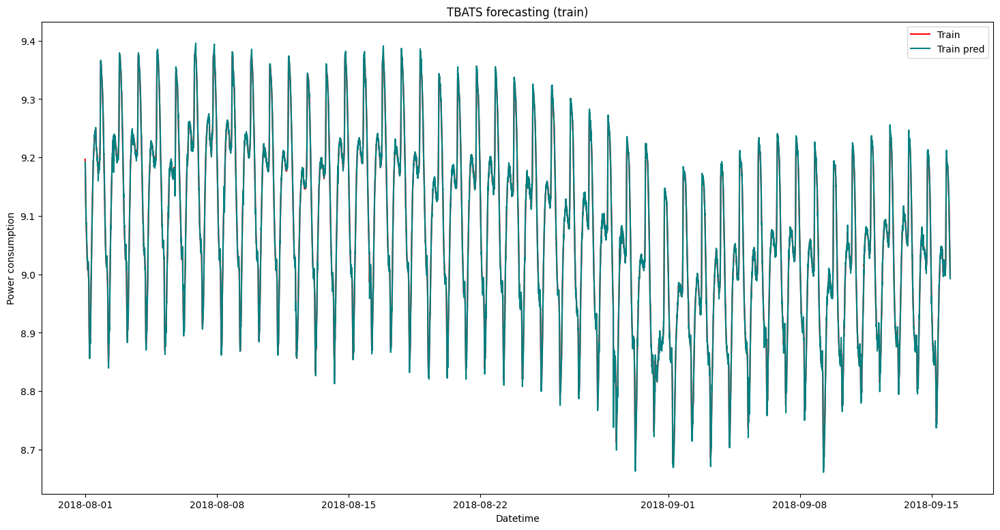

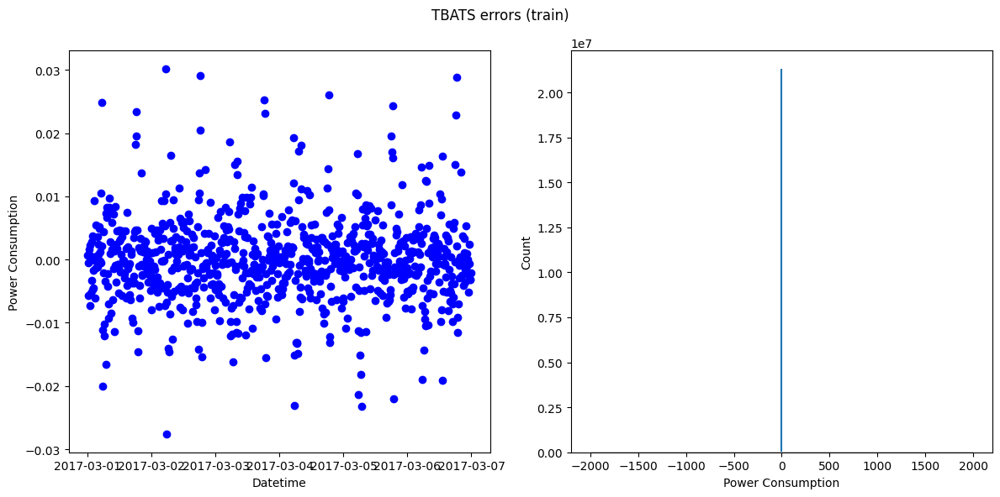

In [107]:
#Train dataset and forecasting visualization
plt.figure(figsize=(18,9))
plt.plot(train['2018-8-01 00:00:00':'2018-9-15 23:50:00'], color='red', linestyle='-', label='Train')
plt.plot(pred_train['2018-8-01 00:00:00':'2018-9-15 23:50:00'], color='teal', linestyle='-', label='Train pred')
#plt.ylim(-50, 350)
plt.xlabel('Datetime')
plt.ylabel('Power consumption')
plt.title('TBATS forecasting (train)')
plt.legend()
plt.show()

fig, (err1, err2) = plt.subplots(1, 2, figsize=(12,6))
fig.suptitle('TBATS errors (train)')
err1.plot(err['2017-03-01 00:00:00':'2017-03-06 23:50:00'], 'bo')
err1.set_xlabel('Datetime')
err1.set_ylabel('Power Consumption')
sns.histplot(err['2017-03-01 00:00:00':'2017-03-06 23:50:00'], bins=13, kde=True, ax=err2, binrange=(-2000,2000))
err2.set_xlabel('Power Consumption')
plt.tight_layout()
plt.show()
